In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install face-alignment
!pip install alphashape
!pip install descartes
!pip install xmltodict

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_nvjitlink_cu12-12.4.127-py3-none-m

In [3]:
import alphashape
import torch
import numpy as np
from copy import copy
import matplotlib.pyplot as plt
import dlib
import alphashape
from shapely.geometry import MultiPoint
import itertools
import shutil
import cv2
from google.colab.patches import cv2_imshow
import os
import sys
import face_alignment
from skimage import io
from sklearn.metrics.pairwise import euclidean_distances
from scipy.optimize import minimize

# 1. Downloading data

In [4]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('DEVICE:', DEVICE)

DEVICE: cuda


In [5]:
data_path = '/content/drive/MyDrive/CV/Final-Project/final_dataset.zip'
!unzip -o {data_path}

Archive:  /content/drive/MyDrive/CV/Final-Project/final_dataset.zip
   creating: final_dataset/
   creating: final_dataset/images/
  inflating: final_dataset/images/t1.jpg  
  inflating: final_dataset/images/t10.jpg  
  inflating: final_dataset/images/t11.png  
  inflating: final_dataset/images/t12.png  
  inflating: final_dataset/images/t13.jpg  
  inflating: final_dataset/images/t14.png  
  inflating: final_dataset/images/t15.png  
  inflating: final_dataset/images/t16.png  
  inflating: final_dataset/images/t17.jpg  
  inflating: final_dataset/images/t18.png  
  inflating: final_dataset/images/t19.png  
  inflating: final_dataset/images/t2.jpg  
  inflating: final_dataset/images/t20.png  
  inflating: final_dataset/images/t21.png  
  inflating: final_dataset/images/t22.png  
  inflating: final_dataset/images/t23.jpg  
  inflating: final_dataset/images/t24.jpg  
  inflating: final_dataset/images/t25.jpg  
  inflating: final_dataset/images/t26.jpg  
  inflating: final_dataset/images/t

In [6]:
data_path = '/content/drive/MyDrive/CV/Final-Project/shape_predictor_68_face_landmarks.dat'
shutil.copy(data_path, '/content/')

'/content/shape_predictor_68_face_landmarks.dat'

In [7]:
!tar -xvf  '/content/drive/MyDrive/CV/Final-Project/Classification.tar'

Classification/JPEGImages/levle0_375.jpg
Classification/JPEGImages/levle2_173.jpg
Classification/JPEGImages/levle0_33.jpg
Classification/JPEGImages/levle0_129.jpg
Classification/JPEGImages/levle0_506.jpg
Classification/JPEGImages/levle1_626.jpg
Classification/JPEGImages/levle1_18.jpg
Classification/JPEGImages/levle1_80.jpg
Classification/JPEGImages/levle3_42.jpg
Classification/JPEGImages/levle1_471.jpg
Classification/JPEGImages/levle1_225.jpg
Classification/JPEGImages/levle0_146.jpg
Classification/JPEGImages/levle0_258.jpg
Classification/JPEGImages/levle0_50.jpg
Classification/JPEGImages/levle1_99.jpg
Classification/JPEGImages/levle2_190.jpg
Classification/JPEGImages/levle0_392.jpg
Classification/JPEGImages/levle2_12.jpg
Classification/JPEGImages/levle0_411.jpg
Classification/JPEGImages/levle0_523.jpg
Classification/JPEGImages/levle1_5.jpg
Classification/JPEGImages/levle1_509.jpg
Classification/JPEGImages/levle1_354.jpg
Classification/JPEGImages/levle1_242.jpg
Classification/JPEGImages

In [8]:
!tar -xvf  '/content/drive/MyDrive/CV/Final-Project/Detection.tar'

Detection/VOC2007/Annotations/levle0_340.xml
Detection/VOC2007/Annotations/levle1_572.xml
Detection/VOC2007/Annotations/levle0_62.xml
Detection/VOC2007/Annotations/levle2_24.xml
Detection/VOC2007/Annotations/levle0_206.xml
Detection/VOC2007/Annotations/levle1_326.xml
Detection/VOC2007/Annotations/levle2_157.xml
Detection/VOC2007/Annotations/levle0_0.xml
Detection/VOC2007/Annotations/levle3_100.xml
Detection/VOC2007/Annotations/levle1_171.xml
Detection/VOC2007/Annotations/levle0_493.xml
Detection/VOC2007/Annotations/levle3_71.xml
Detection/VOC2007/Annotations/levle0_359.xml
Detection/VOC2007/Annotations/levle1_455.xml
Detection/VOC2007/Annotations/levle3_119.xml
Detection/VOC2007/Annotations/levle0_111.xml
Detection/VOC2007/Annotations/levle0_223.xml
Detection/VOC2007/Annotations/levle1_343.xml
Detection/VOC2007/Annotations/levle2_41.xml
Detection/VOC2007/Annotations/levle1_209.xml
Detection/VOC2007/Annotations/levle0_376.xml
Detection/VOC2007/Annotations/levle2_174.xml
Detection/VOC200

In [9]:
data_path = '/content/drive/MyDrive/CV/Final-Project/svm_weights.joblib'
shutil.copy(data_path, '/content/')

'/content/svm_weights.joblib'

# **Functions for Comparison**

In [10]:
'''
Function to calculate the intersection over union for a set of predictions and
ground truth masks
logical_and ---> Calculates the logical AND operation between predicted and ground truth
logical_or ---> Calculates the logical OR operation between predicted and ground truth
intersection ---> Computes and stores the intersection
union ---> Computes and stores the union
'''
def calculate_iou(prediction, ground_truth):
    n_images = len(prediction)
    intersection = 0
    union = 0
    for i in range(n_images):
        logical_and =  np.logical_and(prediction[i] > 0, ground_truth[i] > 0)
        logical_or = np.logical_or(prediction[i] > 0, ground_truth[i] > 0)
        intersection += logical_and.astype(np.float32).sum()
        union += logical_or.astype(np.float32).sum()
    return float(intersection) / union

In [11]:
'''
Function to calculate the recall score for a set of predictions and
ground truth masks
i.e Calculating the proportion of true positives out of all relevant instances
in ground truth
true_positives calculation is done by counting the no.of pixels > 0r
'''
def calculate_recall(prediction, ground_truth):
    n_images = len(prediction)
    intersection = 0
    true_positives = 0
    for i in range(n_images):
        logical_and = np.logical_and(prediction[i] > 0, ground_truth[i] > 0)
        intersection += logical_and.astype(np.float32).sum()
        true_positives += (ground_truth[i] > 0).astype(np.float32).sum()
    return float(intersection) / true_positives


In [12]:
def plot_img(img, cmap='gray'):
    plt.figure(dpi = 300)
    plt.imshow(img, cmap=cmap)
    plt.axis('off')
    plt.show()

# **Functions to find forehead points**

In [13]:
'''
Function to calculate the slope, equation of a line, and euclidean distance
of the two points
'''
def line_from_points(point1, point2):
  x1, y1 = point1
  x2, y2 = point2
  m = (y1-y2)/(x1-x2+ 1e-4)
  b = y1 - m*x1
  d = euclidean_distances(point1.reshape(1,2), point2.reshape(1,2))[0][0]
  return m, b, d

In [14]:
'''
Function to find the intersection point of two lines given their slopes
and y-intercepts
'''
def find_intersection(m1, c1, m2, c2):
    x = (c2-c1)/(m1-m2)
    y = m1*x+c1
    return np.array([x, y]).astype(int)

In [15]:
def func(x, a, b):
  return np.array([x, x*a + b])


'''
Function to calculate point along a line defined by two points A and B
with a specific distance from point A
X_new = X_old ± d/((1+c^2)^0.5)

Y-cordinates for each of the X-cordinates are computed using the func function
Distance is calculated between the computed points and point B
Point closer to point B is chosen
'''
def point_along(pointA, pointB, m, c, dist):
    x1 = pointA[0] - dist*(1/(1 + m**2)**0.5)
    x2 = pointA[0] + dist*(1/(1 + m**2)**0.5)
    dist1 = (((func(x1, m, c) - pointB)**2).sum())**0.5
    dist2 = (((func(x2, m, c) - pointB)**2).sum())**0.5
    if dist1 > dist2:
      x = x1
    else:
      x = x2
    return func(x, m, c)

In [16]:
'''
Function to determine the coefficients to adjust the sizes of different
facial features based on the orientation of face
'''

def face_orientation(all_a): # all_a = [atop, aleft, aright]
  tan = []
  for a in all_a:
    arctan = np.arctan(a)*180/3.14
    if arctan > 0:
      tan.append(arctan)
    else:
      tan.append(180 + arctan)
  diff = []
  for subset in itertools.combinations(tan, 2):
    diff.append(abs(subset[0] - subset[1]))
  if diff[0] < 5:
    # print(1)
    coef = [1.7, 2, 1.8]
  elif diff[1] < 5:
    # print(2)
    coef = [1.7, 1.8, 2]
  elif diff[2] < 5:
    # print(3)
    coef = [1.4, 1.9, 1.9]
  else:
    # print(4)
    coef = [1.7, 1.5, 1.5]
  return coef

In [17]:
'''
Function to calculate and add three points to an existing set of facial landmarks
'''

def add_points(points):
  anose, bnose, Dnose = line_from_points(points[27].astype(float), points[30].astype(float))
  abrow, bbrow, _ = line_from_points(points[21].astype(float), points[22].astype(float))
  base_center = find_intersection(anose, bnose, abrow, bbrow)


  atop, btop, _ = line_from_points(points[0].astype(float), points[16].astype(float))
  aleft, bleft, _ = line_from_points(points[36].astype(float), points[48].astype(float))
  aright, bright, _ = line_from_points(points[45].astype(float), points[54].astype(float))
  base_left = find_intersection(aleft, bleft, atop, btop)
  base_right = find_intersection(aright, bright, atop, btop)

  coefs = face_orientation([anose, aleft, aright])

  A = point_along(base_center, points[30], anose, bnose, Dnose*coefs[0])
  B = point_along(base_left, points[48], aleft, bleft, Dnose*coefs[1])
  C = point_along(base_right, points[54], aright, bright, Dnose*coefs[2])
  return np.array([C, A, B])

# **2. Face detection**

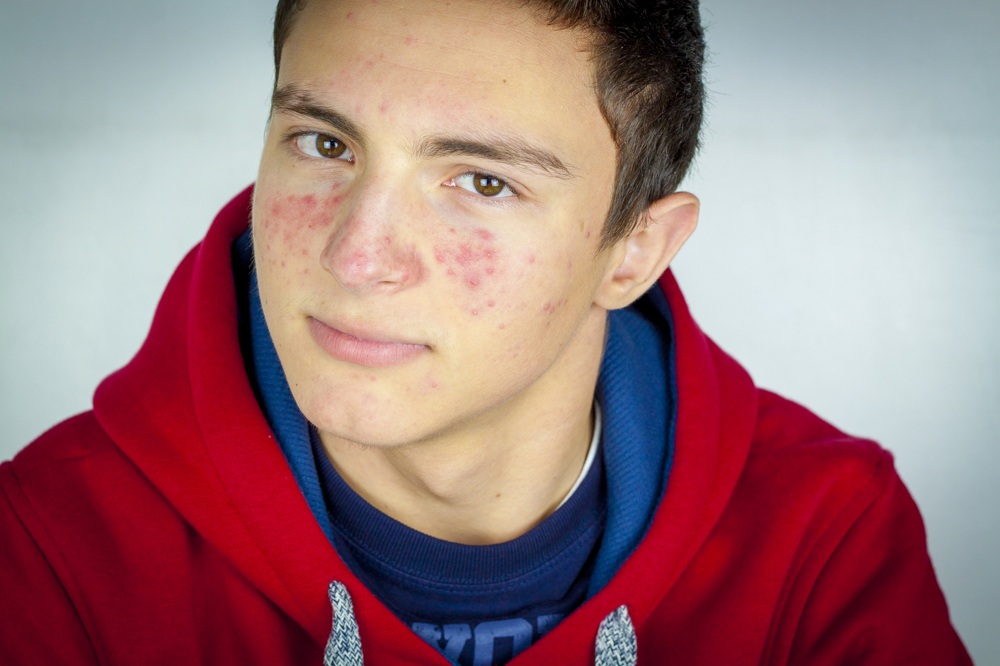

In [18]:
'''
1) First we are loading the image and handling the size of the image
2) We are converting the image to RGB and Grayscale images to reduce memory
usage, and speed up computations
3) Thresholds the grayscale mask to obtain a binary mask where pixel values
above 240 are set to 255 (white) and others to 0 (black)
'''

img_path = '/content/drive/MyDrive/CV/Final-Project/Image2.jpg'
image = cv2.imread(img_path)
image.shape[0]
cv2_imshow(image)

if image.shape[0] > 2500:
  (h, w) = image.shape[:2]
  image = cv2.resize(image, (int(w * 2500 / float(h)), 2500))
imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
imageGRAY = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

## **2.1. DLIB Library**

In [19]:
'''
Initializes a face detector using the dlib library.
The shape_predictor() function loads a pre-trained model that is capable of
predicting the locations of 68 facial landmarks in an image.
'''

detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')

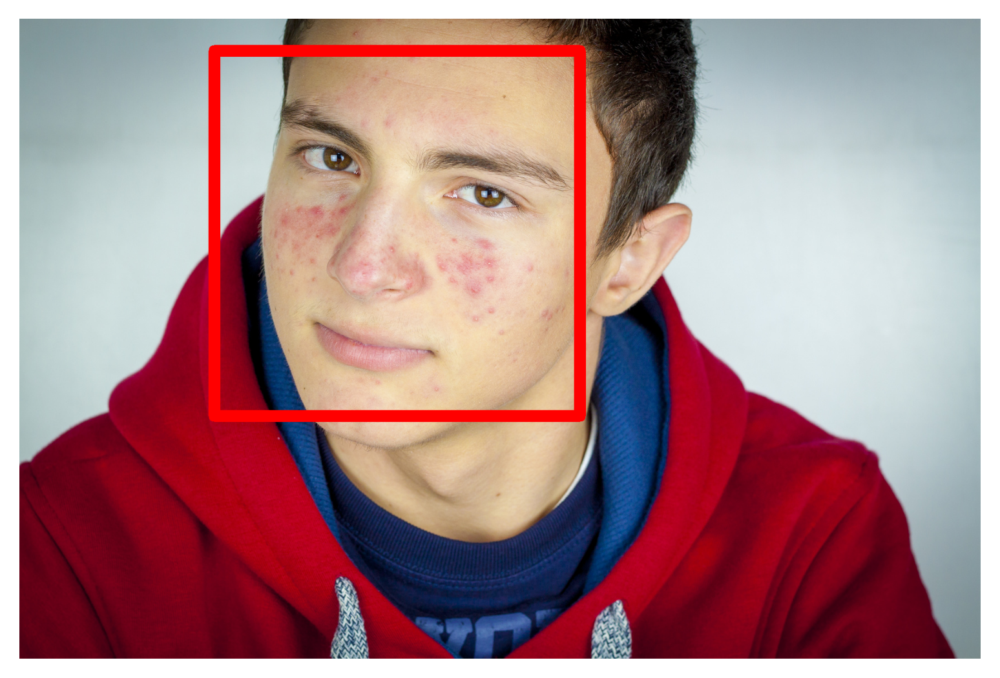

In [20]:
'''
Detects faces in the input grayscale image.The detector() function returns
a list of rectangles, where each rectangle represents the bounding
box of a detected face.
'''
faces = detector(imageGRAY)
img = imageRGB.copy()
for face in faces:
    x = face.left()
    y = face.top()
    w = face.right() - x
    h = face.bottom() - y
    img = cv2.rectangle(img, (x, y), (x + w,y + h), (255, 0, 0), 20)
plot_img(img)

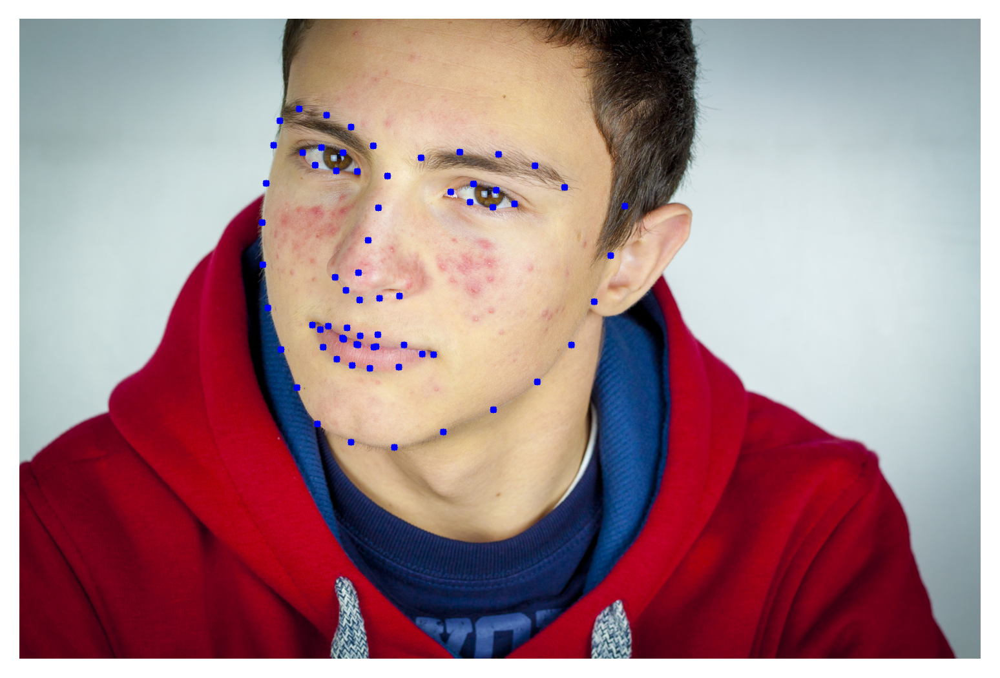

In [21]:
'''
For each detected face, it uses the shape predictor initialized earlier
to predict the locations of 68 facial landmarks that define the pose of the object.
'''
for face in faces:
  shape = predictor(imageGRAY, face)

image_draw = imageRGB.copy()
coords = np.zeros((68, 2))
for i in range(0, 68):
  coords[i] = (shape.part(i).x, shape.part(i).y)
for points in coords:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)
plot_img(image_draw)

## **2.2 Face Alignment Network (FAN) + Additional keypoints generation**

(-0.5, 1687.5, 1124.5, -0.5)

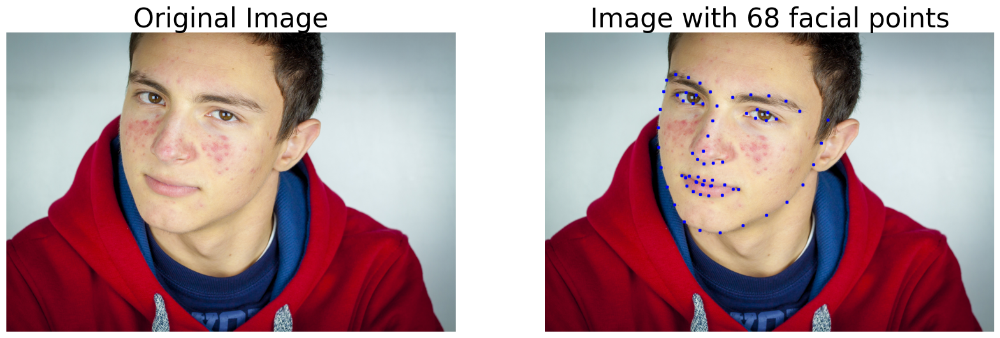

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

ax[0].imshow(imageRGB)
ax[0].set_title('Original Image', fontsize=30)
ax[0].axis('off')

ax[1].imshow(image_draw)
ax[1].set_title('Image with 68 facial points', fontsize=30)
ax[1].axis('off')

Downloading: "https://www.adrianbulat.com/downloads/python-fan/s3fd-619a316812.pth" to /root/.cache/torch/hub/checkpoints/s3fd-619a316812.pth
100%|██████████| 85.7M/85.7M [00:05<00:00, 16.6MB/s]
Downloading: "https://www.adrianbulat.com/downloads/python-fan/2DFAN4-cd938726ad.zip" to /root/.cache/torch/hub/checkpoints/2DFAN4-cd938726ad.zip
100%|██████████| 91.9M/91.9M [00:07<00:00, 12.7MB/s]


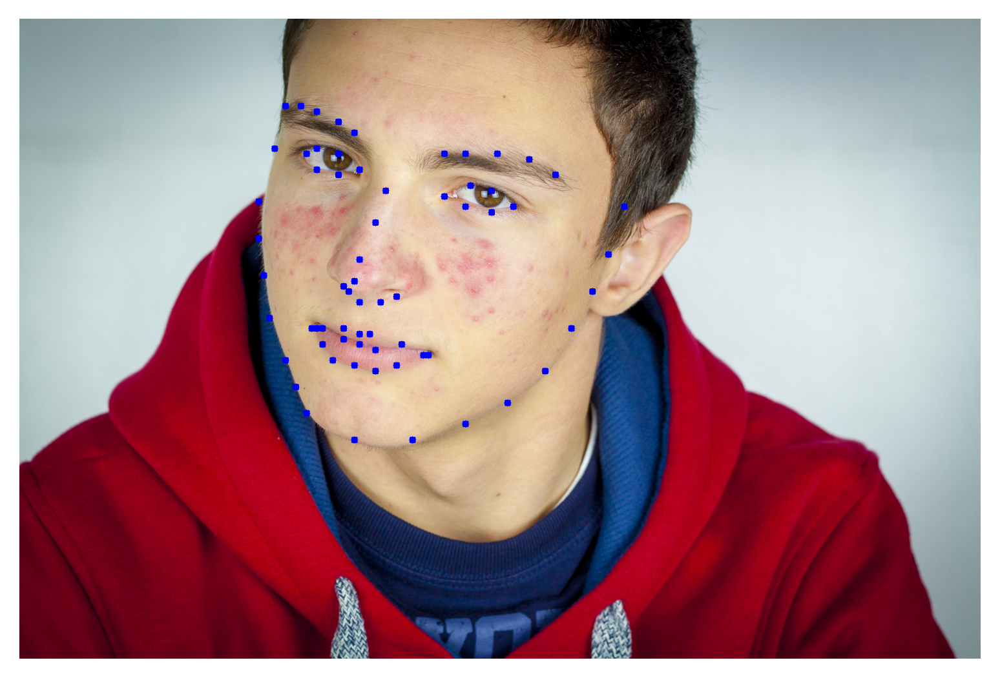

In [23]:
'''
Initializes the face alignment model using the face_alignment library.
The model is configured to predict 2D facial landmarks and returns a list of
predicted landmarks for each detected face in the image.
'''

fa = face_alignment.FaceAlignment(face_alignment.LandmarksType.TWO_D, flip_input=False)
preds = fa.get_landmarks_from_image(imageRGB)

image_draw = copy(imageRGB)
for points in preds[0]:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)
plot_img(image_draw)

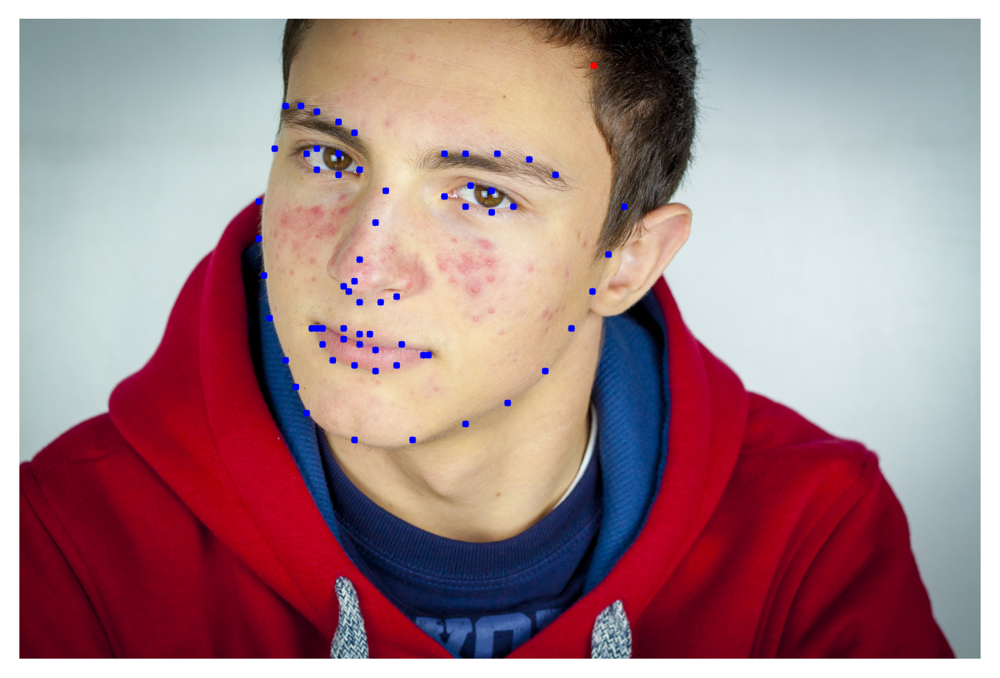

In [24]:
'''
Finding Forehead points additional to the landmark points to provide more
context and information about the facial structure.
'''

image_draw = copy(imageRGB)

for points in preds[0]:
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (0, 0, 255), 10)

# Additional points for forehead
for points in add_points(preds[0]):
  cv2.circle(image_draw, (points[0].astype(int), points[1].astype(int)), 1, (255, 0, 0), 10)


plot_img(image_draw)

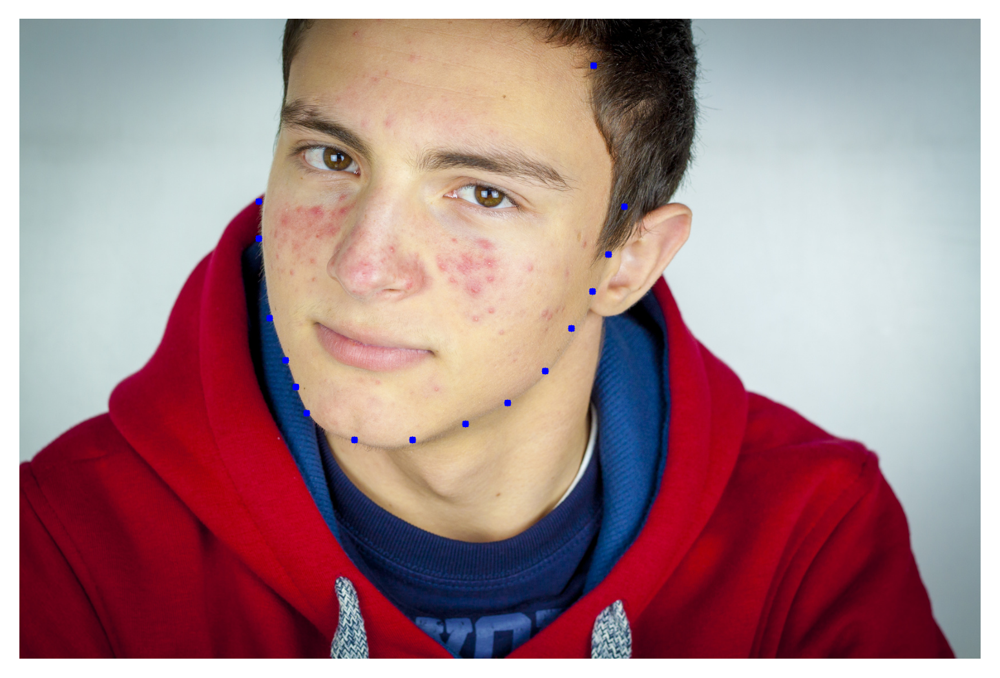

In [25]:
'''
Computing the convex hull of the facial landmarks helps in understanding the
verall shape and structure of the face.
The convex hull represents the outer boundary of the facial landmarks,
which can be useful for tasks like face recognition, face alignment.
'''

image_draw = copy(imageRGB)
points_71 = np.vstack((preds[0], add_points(preds[0])))

# Convert all points to float
points_71 = points_71.astype(float)

# Convert to MultiPoint object
multi_point = MultiPoint(list(map(tuple, points_71)))

# Extract hull coordinates
hull = multi_point.convex_hull
hull_pts_x, hull_pts_y = hull.exterior.coords.xy

# Draw circles on the image for each hull point
for i in range(len(hull_pts_x)):
    center_x = int(hull_pts_x[i])
    center_y = int(hull_pts_y[i])
    cv2.circle(image_draw, (center_x, center_y), 1, (0, 0, 255), 10)

plot_img(image_draw)

# **3. Acne detection**

## **3.1. Thresholding based on skin color**

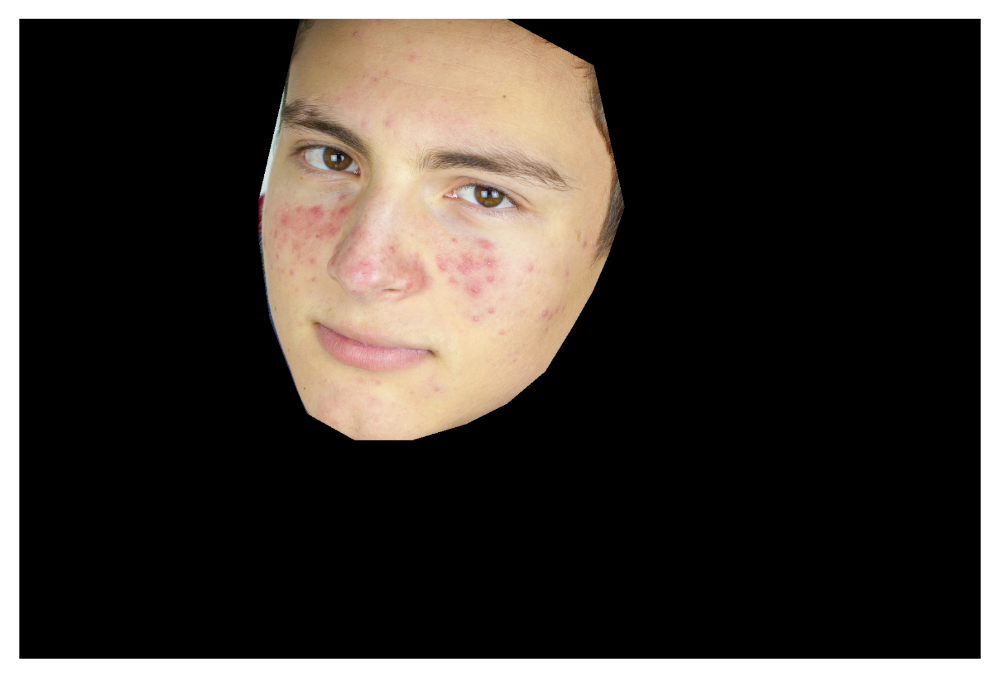

In [26]:
'''
This cell fills the convex hull of facial landmarks with white color and masks
the original image, then performs erosion operation to refine the mask.
The resulting masked image is displayed, showing only the facial region with
noise removed and boundaries refined.
'''

img_cnt = np.zeros(imageRGB.shape[:-1])
image_draw = copy(imageRGB)

face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
image_draw[img_cnt == 0] = 0

plt.figure(dpi = 300)
plt.imshow(image_draw)
plt.axis('off')

kernel = np.ones((5,5),np.uint8)
eros = cv2.erode(img_cnt, kernel,iterations = 5)

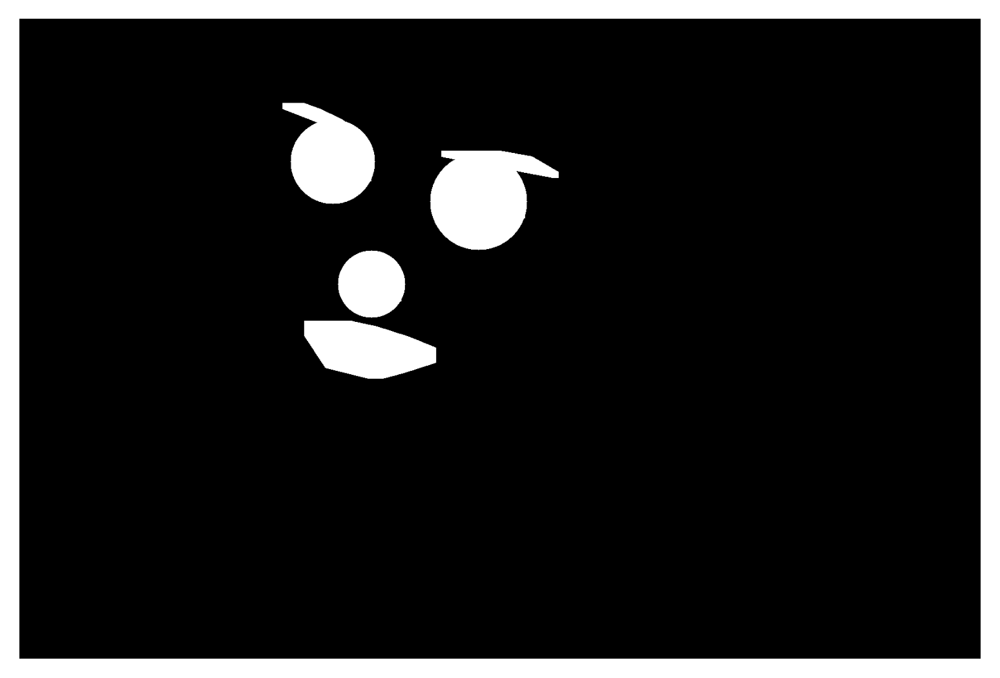

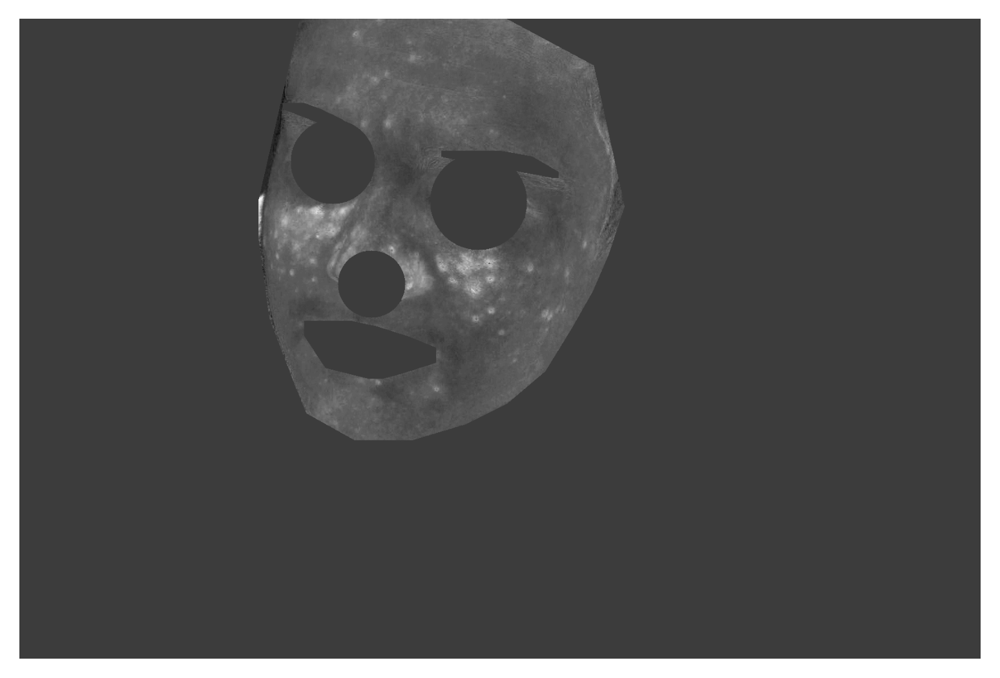

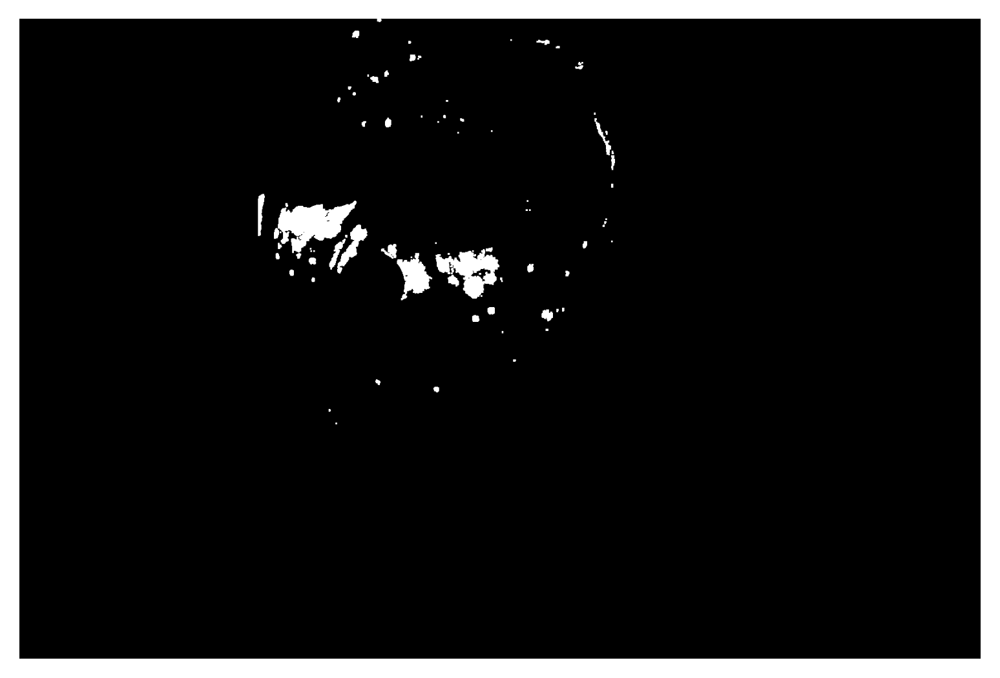

In [27]:
'''
1) We are segmenting the facial parts using landmark indices and extracted
them (left_eyebrow,right_eyebrow...etc)
2) The if-elif-else statement segment facial parts based on the position of specific
landmarks (points_71).
3) If the x-coordinate of the left eyebrow's inner edge (points_71[16][0]) is less
than the x-coordinate of the nose tip (points_71[33][0]), it suggests the face
is tilted to the left.
4) In this case, only the left facial parts (left eyebrow, left eye, nose,
and mouth) are considered.
5) Converted the RGB image to LAB color space to analyze the A channel(which
mostly indicates th skin color variations for acne).
'''

img_cnt_1 = np.zeros(imageRGB.shape[:-1])

left_eyebrow = points_71[17:22]
right_eyebrow = points_71[22:27]
left_eye = points_71[36:42]
right_eye = points_71[42:48]
mouth = points_71[48:60]
nose = points_71[29:36]

nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]
alpha = MultiPoint(list(map(tuple,mouth)))
hull = alpha.convex_hull
hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy
mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

if points_71[16][0] < points_71[33][0]:
  face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 13]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
elif points_71[1][0] > points_71[33][0]:
  face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 13]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
else:
  face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 5, 20, 8, 13]
  labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

for (part, iter, label) in zip(face_parts, iterations, labels):
  img_iter = np.zeros(imageRGB.shape[:-1])
  cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
  img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
  if (label == 'eye') | (label == 'nose'):
    contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = cv2.minEnclosingCircle(contours[0])
    center = (int(x),int(y))
    if (label == 'nose'):
      radius = int(radius*1)
    if (label == 'eye'):
      radius = int(radius*1)
    cv2.circle(img_iter, center, radius, (1), -1)
  img_cnt_1 += img_iter
img_cnt_1 = (img_cnt_1>0)*1
plot_img(img_cnt_1)

acne_mask = image_draw.copy()
img_lab = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2LAB)

A = img_lab[:, :, 1]
A[img_cnt_1 > 0] = 128

plot_img(A)

th = np.sum(A*(A > 128))/(np.sum(1*(A > 128)))
A_th = (A>th*1.055).astype(np.uint8)
kernel = np.ones((3,3))
A_th = cv2.morphologyEx(A_th, cv2.MORPH_CLOSE, kernel, iterations = 1)
A_th = cv2.dilate(np.uint8(A_th), kernel=np.ones((3, 3)), iterations = 1)

plot_img(A_th)

A_th[img_cnt_1 > 0] = 0
img_bin = A_th.copy()

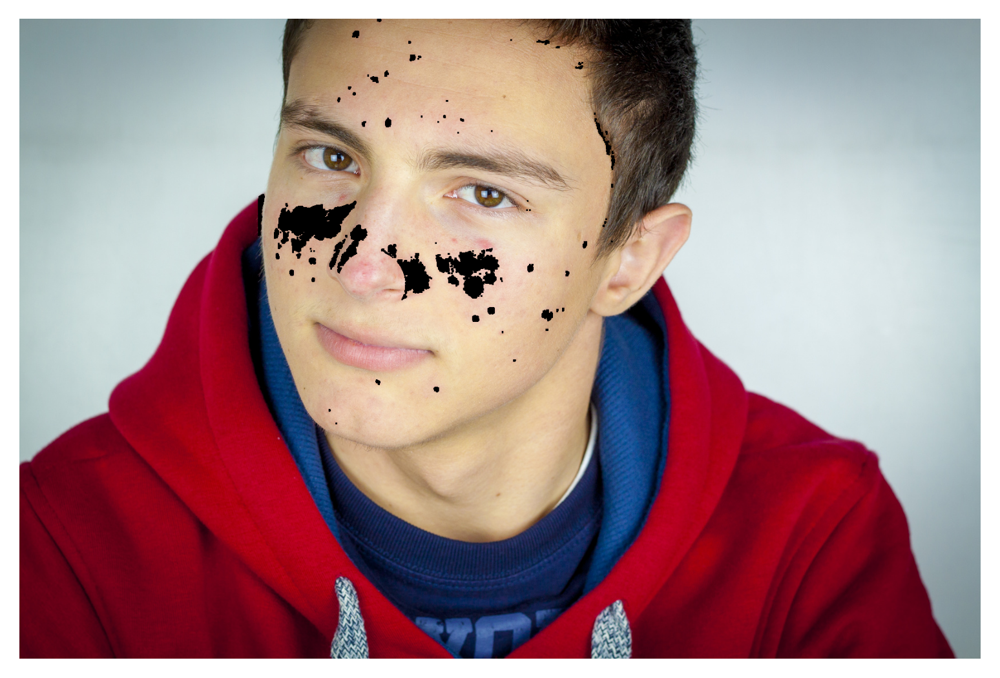

In [28]:
'''
Applied the acne mask on the image and displayed it
'''

final_img = imageRGB.copy()
final_img[img_bin == 1] = 0
acne_mask = np.ones(img_bin.shape)
acne_mask[img_bin == 1] = 0

plot_img(final_img)

prediction = acne_mask.astype(np.uint8)-1

## **3.2. Thresholding on difference**

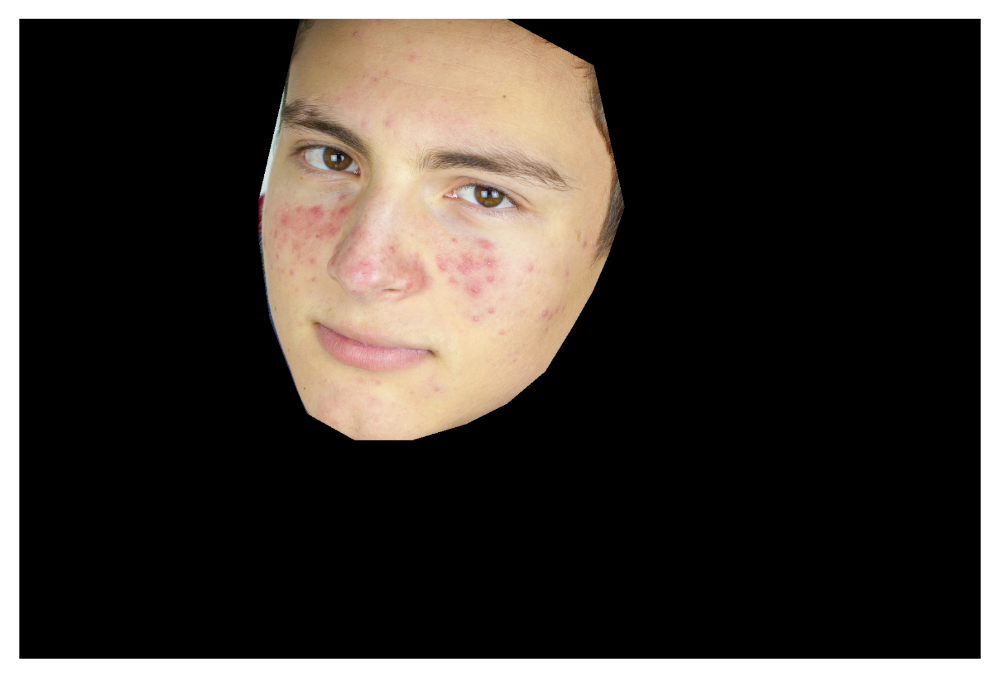

In [29]:
img_cnt = np.zeros(imageRGB.shape[:-1])
image_draw = copy(imageRGB)

face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
image_draw[img_cnt == 0] = 0

plt.figure(dpi = 300)
plt.imshow(image_draw)
plt.axis('off')

kernel = np.ones((5,5),np.uint8)
eros = cv2.erode(img_cnt, kernel,iterations = 5)

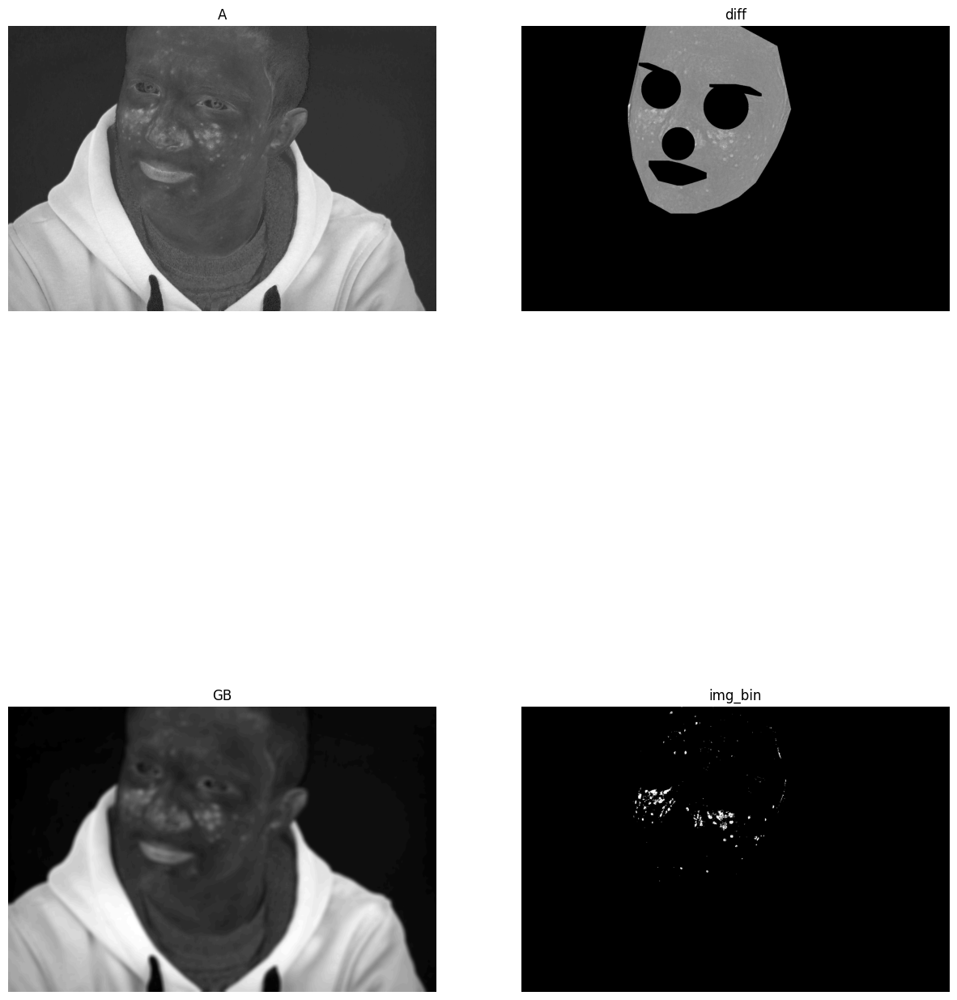

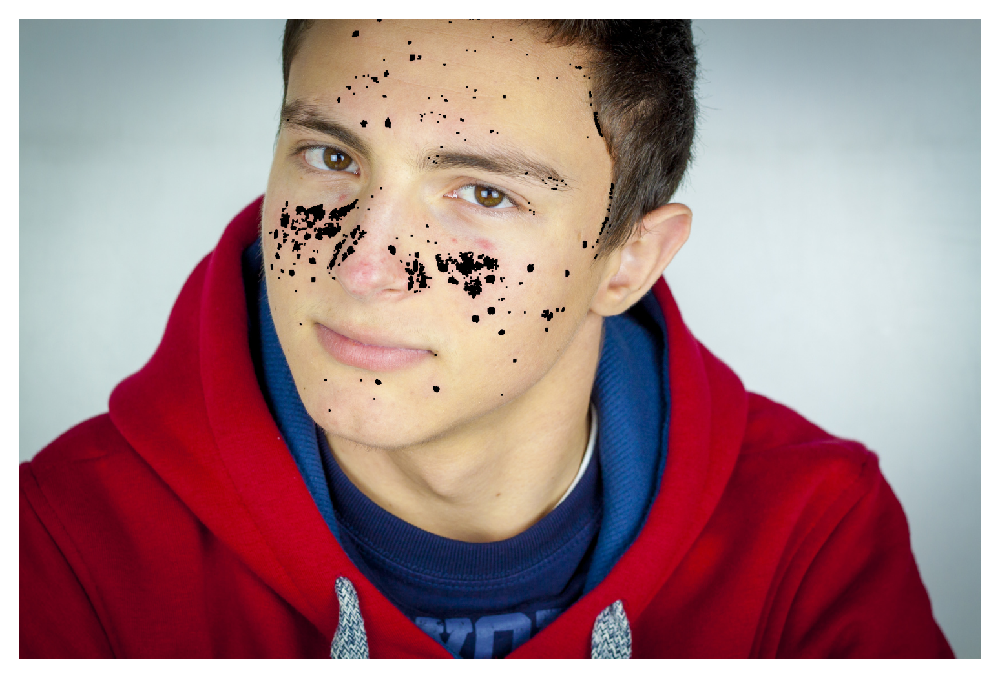

In [30]:
'''
1) img_cnt_1 -- > represent the regions of interest (facial features) in the image.
It contains non-zero values where facial features are detected.
2) img_cnt --> It is the polygon of face fored from the precomputed hull points .
3) diff --> This likely identifies areas where facial features are not present
or where the mask img_cnt is not active.
4) It calculates the difference between the original feature and a Gaussian
blurred version (A - GB).
5) This likely helps in highlighting certain patterns or anomalies in these features.
6) The code applies thresholding (diff > 42) and morphological
operations (dilation) to isolate regions that potentially contain acne
'''

img_cnt_1 = np.zeros(imageRGB.shape[:-1])

left_eyebrow = points_71[17:22]
right_eyebrow = points_71[22:27]
left_eye = points_71[36:42]
right_eye = points_71[42:48]
mouth = points_71[48:60]
nose = points_71[29:36]

acne_mask = imageRGB.copy()
img_lab = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2LAB)
img_hsv = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2HSV)
img_hls = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2HLS)
img_gray = cv2.cvtColor(acne_mask, cv2.COLOR_RGB2GRAY)

L = img_lab[:, :, 0]
A = img_lab[:, :, 1]
B = img_lab[:, :, 2]

fig, ax = plt.subplots(2, 2, figsize=(15, 20))
ax[0][0].imshow(A, cmap='gray')
ax[0][0].set_title('A')
ax[0][0].axis('off')

kernel = np.ones((19,19), np.float32)/500
GB = cv2.filter2D(A ,-1, kernel)
ax[1][0].imshow(GB, cmap='gray')
ax[1][0].set_title('GB')
ax[1][0].axis('off')

diff = A-GB

nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]
alpha = MultiPoint(list(map(tuple,mouth)))
hull = alpha.convex_hull
hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy

mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

if points_71[16][0] < points_71[33][0]:
  face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
elif points_71[1][0] > points_71[33][0]:
  face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'nose', 'mouth']
else:
  face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
  iterations = [5, 20, 5, 20, 8, 11]
  labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

for (part, iter, label) in zip(face_parts, iterations, labels):
  img_iter = np.zeros(imageRGB.shape[:-1])
  cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
  img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
  if (label == 'eye') | (label == 'nose'):
    contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = cv2.minEnclosingCircle(contours[0])
    center = (int(x),int(y))
    if (label == 'nose'):
      radius = int(radius*1.1)
    if (label == 'eye'):
      radius = int(radius*1.05)
    cv2.circle(img_iter, center, radius, (1), -1)
  img_cnt_1 += img_iter
img_cnt_1 = (img_cnt_1>0)*1
diff[(img_cnt_1 - 1)*(-1)*img_cnt == 0] = 0


ax[0][1].imshow(diff, cmap='gray')
ax[0][1].set_title('diff')
ax[0][1].axis('off')

# thresholding the intensity value
img_bin = (diff>42)*1
img_bin[eros == 0] = 0
ax[1][1].imshow(img_bin, cmap='gray')
ax[1][1].set_title('img_bin')
ax[1][1].axis('off')

final_img = imageRGB.copy()
img_bin = cv2.dilate(np.uint8(img_bin), kernel=np.ones((3, 3)), iterations = 1)
final_img[img_bin == 1] = 0
acne_mask = np.ones(img_bin.shape)
acne_mask[img_bin == 1] = 0

prediction = acne_mask.astype(np.uint8)-1

plot_img(final_img)

# **4. Estimate all (function to process image + metric calculation)**

In [31]:
def find_mask(idx, path, mode, show = True):
  try:
    mask_path=""
    image = cv2.imread(path)
    image.shape[0]
  except (AttributeError) as e:
    img_path = f"final_dataset/images/t{idx}.png"
    mask_path = f"final_dataset/masks/t{idx}_mask.png"
    image = cv2.imread(img_path)

  if image.shape[0] > 2500:
    (h, w) = image.shape[:2]
    image = cv2.resize(image, (int(w * 2500 / float(h)), 2500))
  imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


  fa = face_alignment.FaceAlignment(face_alignment.LandmarksType.TWO_D, flip_input=False)
  preds = fa.get_landmarks_from_image(imageRGB)

  points_71 = np.vstack((preds[0], add_points(preds[0])))
  multi_point = MultiPoint(list(map(tuple, points_71)))

  # Extract hull coordinates
  hull = multi_point.convex_hull
  hull_pts_x, hull_pts_y = hull.exterior.coords.xy

  img_cnt = np.zeros(imageRGB.shape[:-1])
  image_draw = copy(imageRGB)

  face = np.vstack([np.array(hull_pts_x), np.array(hull_pts_y)]).T
  cv2.fillPoly(img_cnt, pts = [face.astype(int)], color=(1))
  image_draw[img_cnt == 0] = 0

  kernel = np.ones((5,5),np.uint8)
  eros = cv2.erode(img_cnt, kernel,iterations = 5)

  img_cnt_1 = np.zeros(imageRGB.shape[:-1])
  left_eyebrow = points_71[17:22]
  right_eyebrow = points_71[22:27]
  left_eye = points_71[36:42]
  right_eye = points_71[42:48]
  mouth = points_71[48:60]
  nose = points_71[29:36]

  nose_n = cv2.convexHull(nose.astype(int))[:, 0, :]

  multi_point = MultiPoint(list(map(tuple, mouth)))

  # Extract hull coordinates
  hull = multi_point.convex_hull
  hull_pts_x_m, hull_pts_y_m = hull.exterior.coords.xy

  mouth_m = np.vstack([np.array(hull_pts_x_m), np.array(hull_pts_y_m)]).T

  if points_71[16][0] < points_71[33][0]:
    face_parts = [left_eyebrow, left_eye, nose_n, mouth_m]
    iterations = [5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'nose', 'mouth']
  elif points_71[1][0] > points_71[33][0]:
    face_parts = [right_eyebrow, right_eye, nose_n, mouth_m]
    iterations = [5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'nose', 'mouth']
  else:
    face_parts = [left_eyebrow, left_eye, right_eyebrow, right_eye, nose_n, mouth_m]
    iterations = [5, 20, 5, 20, 8, 11]
    labels = ['eyebrow', 'eye', 'eyebrow', 'eye', 'nose', 'mouth']

  for (part, iter, label) in zip(face_parts, iterations, labels):
    img_iter = np.zeros(imageRGB.shape[:-1])
    cv2.fillPoly(img_iter, pts = [part.astype(int)], color=(1))
    img_iter = cv2.dilate(img_iter, kernel=np.ones((3, 3)), iterations=iter)
    if (label == 'eye') | (label == 'nose'):
      contours, hierarchy = cv2.findContours(img_iter.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
      (x,y),radius = cv2.minEnclosingCircle(contours[0])
      center = (int(x),int(y))
      if (label == 'nose'):
        radius = int(radius*1.1)
      if (label == 'eye'):
        radius = int(radius*1.05)
      cv2.circle(img_iter, center, radius, (1), -1)
    img_cnt_1 += img_iter
  img_cnt_1 = (img_cnt_1>0)*1

  img_lab = cv2.cvtColor(imageRGB.copy(), cv2.COLOR_RGB2LAB)

  A = img_lab[:, :, 1]

  if mode == '1st':
    A[img_cnt_1 > 0] = 128
    A[img_cnt == 0] = 128
    th = np.sum(A*(A > 128))/(np.sum(1*(A > 128)))
    A_th = (A>th*1.05).astype(np.uint8)
    kernel = np.ones((3,3))
    A_th = cv2.morphologyEx(A_th, cv2.MORPH_CLOSE, kernel, iterations = 1)
    A_th = cv2.dilate(np.uint8(A_th), kernel=np.ones((3, 3)), iterations = 1)
    A_th[img_cnt_1 > 0] = 0
    img_bin = A_th.copy()

    final_img = imageRGB.copy()
    final_img[img_bin == 1] = 0
    acne_mask = np.ones(img_bin.shape)
    acne_mask[img_bin == 1] = 0
    prediction = acne_mask.astype(np.uint8)-1

  if mode == '2nd':
    kernel = np.ones((19,19), np.float32)/500
    GB = cv2.filter2D(A ,-1, kernel)
    diff = A-GB
    diff[(img_cnt_1 - 1)*(-1)*img_cnt == 0] = 0

    img_bin = (diff>42)*1
    img_bin[eros == 0] = 0

    final_img = imageRGB.copy()
    img_bin = cv2.dilate(np.uint8(img_bin), kernel=np.ones((3, 3)), iterations = 1)
    final_img[img_bin == 1] = 0
    acne_mask = np.ones(img_bin.shape)
    acne_mask[img_bin == 1] = 0
    prediction = acne_mask.astype(np.uint8)-1

  # score=0
  if show==False:
    if(mask_path==""):
      mask_path = f"final_dataset/masks/t{idx}_mask.jpg"
    # print(mask_path)
    ground_truth = cv2.imread(mask_path)
    ground_truth = cv2.cvtColor(ground_truth, cv2.COLOR_BGR2GRAY)
    ground_truth = np.uint8((ground_truth > 240)*255)
    score = calculate_recall([prediction], [ground_truth])
    # print(score)

  if show:
    # print(score)

    fig, ax = plt.subplots(2, 1, figsize=(10, 20))

    ax[0].imshow(imageRGB)
    ax[0].set_title('Image')
    ax[0].axis('off')

    superpos_pr = imageRGB.copy()
    superpos_pr[prediction == 255] = 0
    ax[1].imshow(superpos_pr)
    ax[1].set_title('Superposotion_prediction')
    ax[1].axis('off')

    return final_img, prediction, acne_mask

  return final_img, prediction, acne_mask, score

In [32]:
scores_1 = []
scores_2 = []
for idx in range(1,31):
  final_img, prediction, acne_mask, score = find_mask(idx=idx, path = f"final_dataset/images/t{idx}.jpg", mode = '1st', show = False)
  scores_1.append(score)
  final_img, prediction, acne_mask, score = find_mask(idx=idx, path = f"final_dataset/images/t{idx}.jpg", mode = '2nd', show = False)
  scores_2.append(score)
  print(idx, '\t', round(scores_1[idx-1], 3), '\t', round(scores_2[idx-1], 3))

1 	 0.681 	 0.573
2 	 0.95 	 0.619
3 	 0.458 	 0.531
4 	 0.634 	 0.774
5 	 0.131 	 0.148
6 	 0.353 	 0.597
7 	 0.075 	 0.07
8 	 0.44 	 0.868
9 	 0.27 	 0.667
10 	 0.693 	 0.465
11 	 0.771 	 0.683
12 	 0.362 	 0.304
13 	 0.685 	 0.567
14 	 0.611 	 0.715
15 	 0.554 	 0.545
16 	 0.442 	 0.448
17 	 0.333 	 0.547
18 	 0.493 	 0.6
19 	 0.534 	 0.608
20 	 0.239 	 0.305
21 	 0.358 	 0.3
22 	 0.479 	 0.617
23 	 0.475 	 0.493
24 	 0.117 	 0.06
25 	 0.126 	 0.12
26 	 0.202 	 0.519
27 	 0.332 	 0.494
28 	 0.668 	 0.798
29 	 0.373 	 0.38
30 	 0.423 	 0.52


In [33]:
scores_1 = np.array(scores_1)
scores_2 = np.array(scores_2)

print(np.mean(scores_1))
print(np.mean(scores_2))

0.4420409534264906
0.49792804759217424


In [34]:
if np.mean(scores_1)>np.mean(scores_2):
  mode= '1st'
else:
  mode='2nd'

print(mode)

2nd


# **5. Inpainting**

In [35]:
image = cv2.imread('/content/drive/MyDrive/CV/Final-Project/Image2.jpg')
image.shape[0]
imageRGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

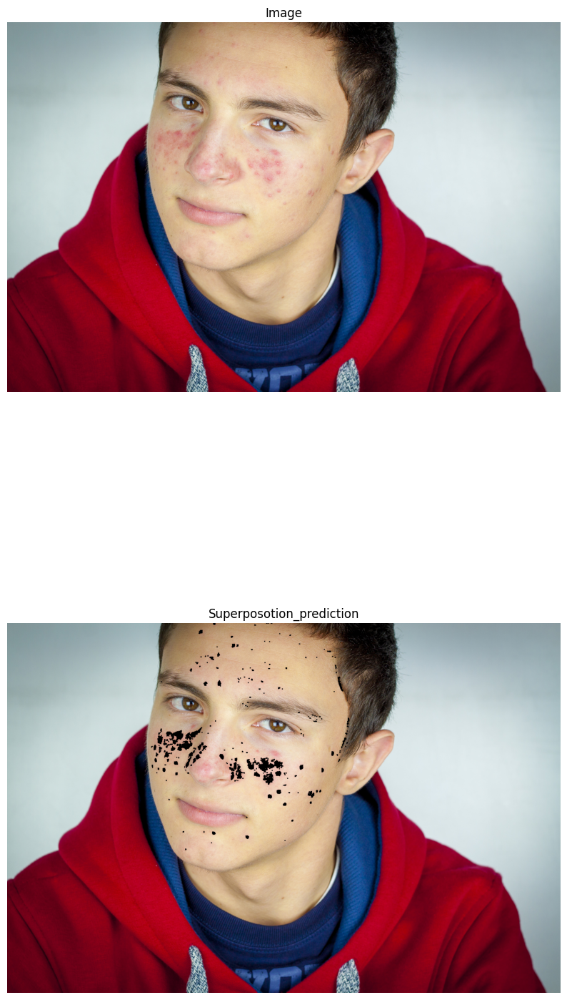

In [36]:
final_img, prediction, acne_mask = find_mask(idx=idx, path = '/content/drive/MyDrive/CV/Final-Project/Image2.jpg', mode = mode, show = True)

## **5.1. OpenCV integrated inpainting**

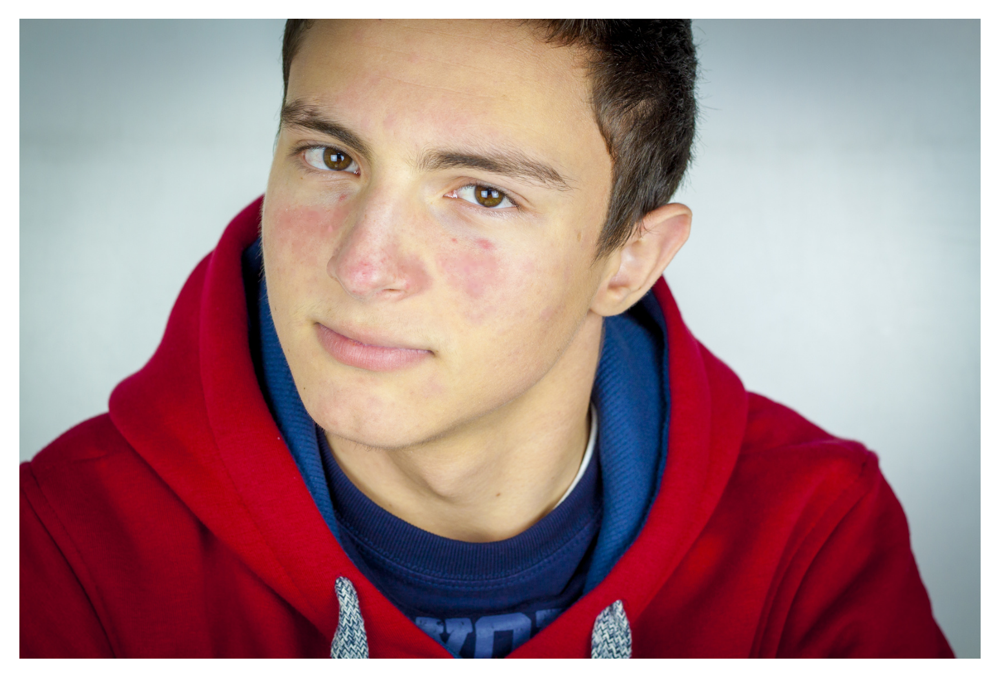

In [37]:
inpainted_by_cv2 = cv2.inpaint(final_img, (acne_mask.astype(np.uint8)-1), 3, cv2.INPAINT_TELEA)
cv2.imwrite('inpainted_by_cv2.jpg', np.uint8(cv2.cvtColor(np.uint8(inpainted_by_cv2), cv2.COLOR_RGB2BGR)))
plot_img(inpainted_by_cv2)

## **5.2. Deep Image Priop**

In [38]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

import torchvision
from torchvision import transforms, models
from PIL import Image
import glob
import random
from tqdm.notebook import tqdm

In [39]:
class Down(nn.Module):
    def __init__(self, in_channels, out_channels, p):
        super().__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.InstanceNorm2d(out_channels)
        self.drop = nn.Dropout(p)
        self.relu1 = nn.LeakyReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.InstanceNorm2d(out_channels)
        self.relu2 = nn.LeakyReLU()

        self.maxpool = nn.MaxPool2d(kernel_size=2)

    def forward(self, x):

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.drop(out)
        out = self.relu1(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out_before_pooling = self.relu2(out)
        out = self.maxpool(out_before_pooling)

        return out, out_before_pooling

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, p, concat=True, deconv=False, mode='nearest'):
        super().__init__()

        if deconv:
            self.upsample = nn.ConvTranspose2d(in_channels, in_channels, 4, stride=2, padding=1)
        else:
            self.upsample = nn.Upsample(scale_factor=2, mode=mode)
        if concat:
            self.conv1 = nn.Conv2d(2*in_channels, out_channels, kernel_size=3, padding=1)
        else:
            self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.InstanceNorm2d(out_channels)
        self.drop = nn.Dropout(p)
        self.relu1 = nn.LeakyReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.InstanceNorm2d(out_channels)
        self.relu2 = nn.LeakyReLU()
        self.concat = concat

    def forward(self, x, x_bridge):

        out = self.upsample(x)
        if self.concat:
            out = torch.cat([out, x_bridge], dim=1)
        out = self.conv1(out)
        out = self.bn1(out)
        out = self.drop(out)
        out = self.relu1(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu2(out)

        return out

class Unet(nn.Module):
  def __init__(self, p, base_channels=16, concat=True, deconv=False, mode='nearest'):
        super().__init__()

        self.down = nn.ModuleList([
            Down(3, base_channels, p),
            Down(base_channels, base_channels * 2, p),
            Down(base_channels * 2, base_channels * 4, p),
            Down(base_channels * 4, base_channels * 8, p),
            Down(base_channels * 8, base_channels * 8, p),
        ])
        self.up = nn.ModuleList([
            Up(base_channels * 8, base_channels * 4, p, concat, deconv, mode),
            Up(base_channels * 4, base_channels * 2, p, concat, deconv, mode),
            Up(base_channels * 2, base_channels, p, concat, deconv, mode),
            Up(base_channels, base_channels, p, concat, deconv, mode)
        ])
        self.final_block = nn.Sequential(
            nn.Conv2d(base_channels, 3, kernel_size=1),
            nn.Sigmoid()
        )


  def forward(self, x):
      out = x
      outputs_before_pooling = []
      for i, block in enumerate(self.down):
          out, before_pooling = block(out)
          outputs_before_pooling.append(before_pooling)
      out = before_pooling

      for i, block in enumerate(self.up):
          out = block(out, outputs_before_pooling[-i - 2])
      out = self.final_block(out)

      return out

In [40]:
def crop_image(img, d=64):
    hor = img.shape[0] % d
    ver = img.shape[1] % d
    img_cropped = img[hor//2: img.shape[0] - (hor - hor//2), ver//2:img.shape[1]-(ver - ver//2)]
    return img_cropped

def imshow(images):
    for i in range(len(images)):
        plt.figure(figsize=(15, 15))
        plt.imshow(np.transpose(images[i].numpy(), (1, 2, 0)))
        plt.axis('off')

In [41]:
kate = torch.from_numpy(crop_image(crop_image(final_img/255).astype(float), 16).transpose(2,0,1))
kate_mask = torch.from_numpy(crop_image(acne_mask).astype(float)).unsqueeze(0)

gen_kate = torch.Generator()
gen_kate.manual_seed(305)
z_kate = torch.FloatTensor(kate.shape).uniform_(0, 1, generator=gen_kate)

In [42]:
model_kate = Unet(p=0.05).cuda()
criterion = nn.MSELoss()
optimizer_kate = torch.optim.Adam(model_kate.parameters(), lr=0.01)

In [43]:
def train(epochs, model, image_train, mask, z, optimizer, iter):
    images = []
    for epoch in range(1, epochs + 1):
        # print(epoch)
        model.train()
        image_train = image_train.cuda()
        mask = mask.cuda()
        out_image = model(z[None, ...].cuda())
        loss = criterion(out_image*mask[None, ...], image_train[None, ...])

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if epoch%iter == 0 or epoch == 1:
            model.eval()
            predict = model(z[None, ...].cuda())
            images.append(predict.detach().cpu().reshape(image_train.shape))


    return predict, images

In [44]:
kate_impainting, kate_images = train(5000, model_kate, kate, kate_mask, z_kate, optimizer_kate, 500)

True

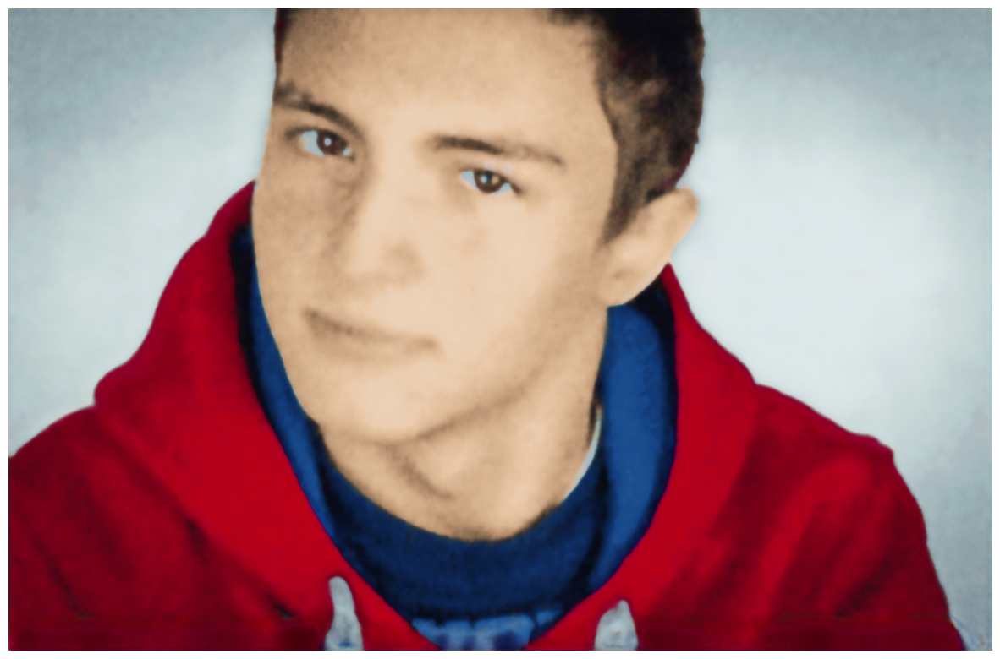

In [47]:
imshow([kate_images[-1].detach().cpu().reshape(kate.shape)])
img_for_save = np.transpose(kate_images[-1].detach().cpu().reshape(kate.shape).numpy(), (1, 2, 0))*255
cv2.imwrite('prior.jpg', np.uint8(cv2.cvtColor(img_for_save, cv2.COLOR_RGB2BGR)))

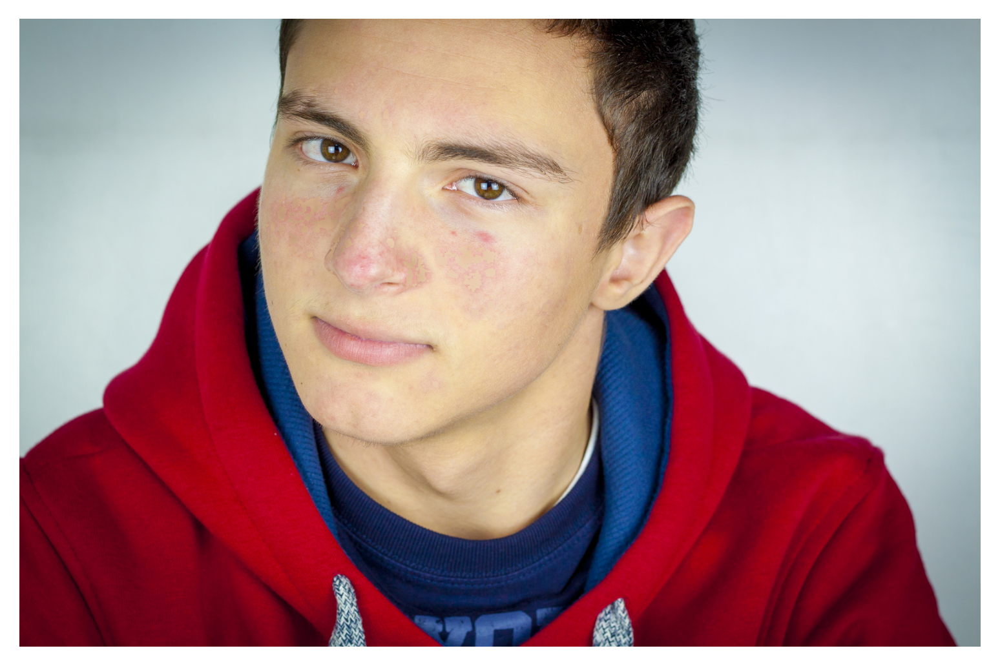

In [46]:
new_img = crop_image(final_img/255) + img_for_save/255*crop_image((acne_mask==0)*1)[:, :, np.newaxis]
cv2.imwrite('final_prior.jpg', np.uint8(cv2.cvtColor(np.uint8(new_img*255), cv2.COLOR_RGB2BGR)))
cv2.imwrite('final_original.jpg', np.uint8(cv2.cvtColor(crop_image(imageRGB), cv2.COLOR_RGB2BGR)))
plot_img(new_img)